In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip /content/drive/MyDrive/CULane_dataset.zip

Streaming output truncated to the last 5000 lines.
  inflating: driver_161_90frame_labels/06032304_0981.MP4/02430.png  
  inflating: driver_161_90frame_labels/06032304_0981.MP4/02520.png  
  inflating: driver_161_90frame_labels/06032304_0981.MP4/02610.png  
  inflating: driver_161_90frame_labels/06032304_0981.MP4/02700.png  
  inflating: driver_161_90frame_labels/06032304_0981.MP4/02790.png  
  inflating: driver_161_90frame_labels/06032304_0981.MP4/02880.png  
  inflating: driver_161_90frame_labels/06032304_0981.MP4/02970.png  
  inflating: driver_161_90frame_labels/06032304_0981.MP4/03060.png  
  inflating: driver_161_90frame_labels/06032304_0981.MP4/03150.png  
  inflating: driver_161_90frame_labels/06032304_0981.MP4/03240.png  
  inflating: driver_161_90frame_labels/06032304_0981.MP4/03330.png  
  inflating: driver_161_90frame_labels/06032304_0981.MP4/03420.png  
  inflating: driver_161_90frame_labels/06032304_0981.MP4/03510.png  
  inflating: driver_161_90frame_labels/06032304_0981

In [ ]:
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt # plotting
import numpy as np # linear algebra
import os # accessing directory structure
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from PIL import Image
import cv2
#experiment with single image and text file
img_file = "/content/driver_161_90frame/06030819_0755.MP4/00000.jpg"
text_file = "/content/driver_161_90frame/06030819_0755.MP4/00000.lines.txt"

def remove_newlines(fname):
    data=[]
    coordinates =[]
    flist = open(fname).readlines()
    for s in flist:
        data.extend([d for d in s.rstrip('\n').split(" ")  if d!=''])

    data = np.array(data).astype(np.float32)

    for idx in range(0,len(data),2):
        coordinates.append(data[idx:idx+2])
    if(len(data)==0):
        return None , None  , 0 , 0

    else:

        mean_val = np.mean(data)
        std_val = np.std(data)
        return coordinates , data , mean_val  , std_val


In [ ]:
#lets create a image file list with images and text files
from os import walk

img_files = []
label_data=[]
mean_array=[]
std_array = []
coordinate_list=[]
for dirpath, dirnames, filenames in walk("/content/driver_161_90frame"):
    for files in filenames :
        if(files.split(".")[-1]=="jpg"):
            txt_file = os.path.join(dirpath , files.split(".")[0]+str(".lines.txt") )
            coordinates , data , mean_val , std_val  = remove_newlines(txt_file)
            if(data is not None):
                img_files.append(os.path.join(dirpath,files))
                label_data.append( data )
                mean_array.append(mean_val)
                std_array.append(std_val)
                coordinate_list.append(coordinates)

# Data visualization

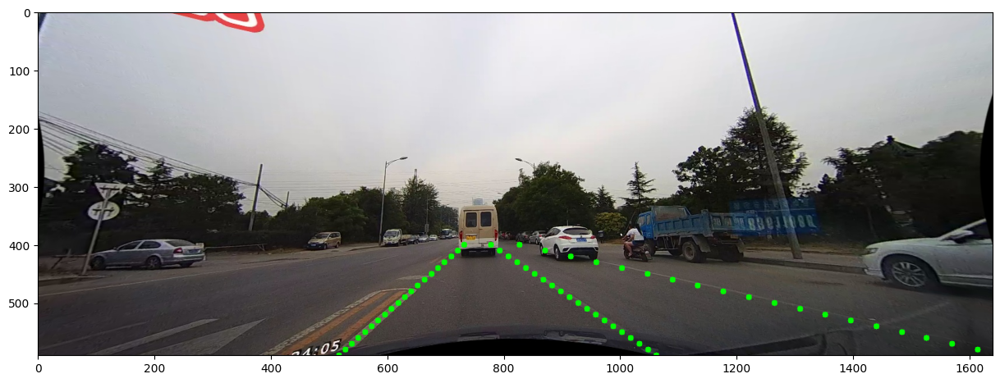

In [ ]:
#plot the image with pth corrdinates
fig = plt.figure(figsize=(15,10))
def plot_data (image_file , coordinates):
    img = cv2.imread(image_file)
    img_rgb = cv2.cvtColor(img , cv2.COLOR_BGR2RGB)
    for x , y in coordinates :
        cv2.circle(img_rgb,(int(float(x)), int(float(y)) ) , 5, (0,255,0), -1)
    plt.imshow(img_rgb)
    plt.show()
plot_data(img_files[0] , coordinate_list[0])

# SCNN Model

In [ ]:
!unzip /content/drive/MyDrive/train_gt.txt.zip

Archive:  /content/drive/MyDrive/train_gt.txt.zip
  inflating: train_gt.txt            


In [ ]:
import os
results=[]
with open("/content/train_gt.txt") as f:
    for line in f :
        line = line.strip()
        data = line.split(" ")
        set1 = data[0].split(os.path.sep)[1:]
        if(set1[0] == "driver_161_90frame"):
            results.append(data)

In [ ]:
import cv2
data_set=[]
for data in results :
    exist=[int(x) for x in data[2:]]
    img_sep = data[0].split(os.path.sep)
    label_sep = data[1].split(os.path.sep)
    label_path = os.path.join("/content/driver_161_90frame_labels" , label_sep[-2], label_sep[-1])
    img_path= os.path.join("../input/culane", img_sep[1] , img_sep[2] , img_sep[3])
    dict_culane={
        "img_path":img_path ,
        "label_path":label_path ,
        "exist":exist
    }
    data_set.append(dict_culane)

In [ ]:
#since we plan to use the pytorch then define the dataset class
from torch.utils.data import Dataset
import torch
from torchvision import transforms
from torch.utils.data import DataLoader
from torch.utils.data import SubsetRandomSampler
import numpy as np
class CreateDataSet(Dataset):
    def __init__(self,data_set , seed):
        self.data_set = data_set
        self.seed = torch.manual_seed(seed)
        self.transform = transforms.Compose([
            transforms.ToPILImage(),
            transforms.Resize((288,800)) ,
            transforms.ToTensor(),
            transforms.Normalize(mean = [0.485, 0.456, 0.406] , std = [0.229, 0.224, 0.225] )
        ])
        self.transform_label = transforms.Compose([
            transforms.ToPILImage(),
            transforms.Resize((288,800)) ,
        ])
        self.transform_exist = transforms.Compose([
            transforms.ToTensor()
        ])
    def __len__(self):
        return len(self.data_set)

    def __getitem__(self,index):
        data_item = self.data_set[index]
        #read the image data
        img = cv2.imread(data_item["img_path"])
        img_rgb = cv2.cvtColor(img , cv2.COLOR_BGR2RGB)
        img_rgb = self.transform(img_rgb)
        #read the label image
        label = cv2.imread(data_item["label_path"])[:,:,0]
        label = np.array(self.transform_label(label))
        if(len(data_item["exist"]) ==4 and label is not None):
            exists = np.array(data_item["exist"])

        else:
            exists = None
        exists = torch.from_numpy(exists)
        sample = {
            "data":img_rgb ,
            "target":label ,
            "exist":exists
        }

        return sample
train_data = CreateDataSet(data_set , 0)

size_train = len(train_data)
idx_list = list(range(size_train))
np.random.seed(0)
np.random.shuffle(idx_list)
train_val_split = 0.2
split_index = int(size_train * train_val_split)

#take the appropriate index values for train and val
train_idx = idx_list[split_index :]
val_idx = idx_list[:split_index]

train_sampler = SubsetRandomSampler(train_idx)
validate_sampler = SubsetRandomSampler(val_idx)

train_loader = DataLoader(train_data ,sampler=train_sampler , batch_size=16 )
valid_loader = DataLoader(train_data , sampler=validate_sampler , batch_size=16)

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models

In [ ]:
class SCNN(nn.Module):
    def __init__(self , input_size , massage_kernel = 9 , pretrained=True):
        super(SCNN , self).__init__()
        self.pretrained = pretrained
        self.net_init(input_size , massage_kernel)
        self.scale_background = 0.4
        self.scale_seg = 1.0
        self.scale_exist = 0.1

        self.ce_loss = nn.CrossEntropyLoss(weight=torch.tensor([self.scale_background, 1, 1, 1, 1]))
        self.bce_loss = nn.BCELoss()

    def net_init(self,input_size , ms_ks):
        input_w , input_h = input_size
        self.fc_input_size = 5 * int(input_w/16) * int(input_h/16)
        self.backbone = models.vgg16_bn(pretrained=self.pretrained).features

        #replace the standard convs with dilated convs
        for i in [34 , 37 , 40]:
            conv = self.backbone._modules[str(i)]
            dilated_conv = nn.Conv2d(conv.in_channels , conv.out_channels  , conv.kernel_size ,
                                    stride=conv.stride , padding = tuple(p*2 for p in conv.padding) ,
                                    dilation=2 , bias = (conv.bias is not None))
            dilated_conv.load_state_dict(conv.state_dict())
            self.backbone._modules[str(i)] = dilated_conv
        self.backbone._modules.pop('33')
        self.backbone._modules.pop('43')

        #scnn unit
        self.layer1 = nn.Sequential(
            nn.Conv2d(512 , 1024 ,3 ,  padding=4 , dilation=4 , bias=False) ,
            nn.BatchNorm2d(1024) ,
            nn.ReLU() ,
            nn.Conv2d(1024 , 128 , 1 , bias=False),
            nn.ReLU()
        )

        # add message passing
        self.message_passing = nn.ModuleList()
        self.message_passing.add_module("up_down" , nn.Conv2d( 128 , 128 , (1 , ms_ks) , padding=(0,ms_ks//2) , bias=False     ))
        self.message_passing.add_module("down_up" , nn.Conv2d(128,128,(1,ms_ks) , padding=(0,ms_ks//2) , bias=False))
        self.message_passing.add_module('left_right',nn.Conv2d(128,128,(ms_ks , 1) , padding=(ms_ks//2 , 0) , bias=False))
        self.message_passing.add_module("right_left" , nn.Conv2d(128,128,(ms_ks , 1) , padding=(ms_ks//2 , 0) , bias=False))

        self.layer2 = nn.Sequential(
            nn.Dropout2d(0.1) ,
            nn.Conv2d(128,5,1)
        )
        self.layer3 = nn.Sequential(
            nn.Softmax(dim=1) ,
            #dimension reducion by 2
            nn.AvgPool2d(2,2) ,
        )

        self.fc = nn.Sequential(
            nn.Linear(self.fc_input_size , 128) ,
            nn.ReLU(),
            nn.Linear(128,4),
            nn.Sigmoid()
        )

    def message_passing_forward(self , x):
        Vertical=[True , True , False , False ]
        Reverse = [False , True , False , True]
        for ms_conv  , v , r in zip(self.message_passing , Vertical , Reverse):
            x = self.message_passing_once(x  , ms_conv , v , r)
        return x

    def message_passing_once(self,x  , ms_conv , vertical=True , reverse=True):
        nB , C , H , W = x.shape
        if vertical :
            slices =[  x[: , : , i : (i+1) , : ] for i in range(H)  ]
            dim=2
        else :
            slices = [ x[: , : , : , i: (i+1)] for i in range(W) ]
            dim=3
        if reverse :
            slices = slices[::-1]

        #then each slice convole with the conv layer and add to the previous layer
        out = [ slices[0]]
        for i in range(1, len(slices)):
            out.append(slices[i]+F.relu(ms_conv(out[i-1])))

        if reverse :
            out = out[::-1]
        #concatenate the tensors with the dimension
        return torch.cat(out , dim=dim)

    def forward(self,img , seg_img=None , exist_gt=None):
        #inference thorught the vgg16 backbone net
        x = self.backbone(img)
        x = self.layer1(x)
        x = self.message_passing_forward(x)
        x = self.layer2(x)

        #then to obtain the original image size need to upsample by 8
        seg_pred = F.interpolate(x  , scale_factor=8 , mode='bilinear' , align_corners=True)
        x = self.layer3(x)
        x = x.view(-1  , self.fc_input_size)
        exist_pred = self.fc(x)

        if seg_img is not None and exist_gt is not None:
            loss_seg = self.ce_loss(seg_pred , seg_img.long().squeeze(1))
            loss_exist = self.bce_loss(exist_pred.float() , exist_gt.float())
            #nned to pay more attention on the segmanetation loss and weight should be high
            loss = loss_seg * self.scale_seg + loss_exist * self.scale_exist

        else:
            loss_seg = torch.tensor(0,dtype=img.dtype , device=img.device)
            loss_exist = torch.tensor(0,dtype=img.dtype , device=img.device)
            loss = torch.tensor(0,dtype=img.dtype , device=img.device)

        return seg_pred , exist_pred , loss_seg , loss_exist , loss


In [ ]:
#define the model
scnn_net = SCNN((800,288) , pretrained=True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16_bn-6c64b313.pth" to /root/.cache/torch/hub/checkpoints/vgg16_bn-6c64b313.pth
100%|██████████| 528M/528M [00:36<00:00, 15.1MB/s]


In [ ]:
#define the optimizer and lr optimizers
import torch.optim as optim
init_lr =  0.0001
max_lr = 0.01
optimizer = optim.SGD(scnn_net.parameters() , lr=init_lr)
#set the learining rate schedulers  scheduler need to be call for every batch operation
scheduler = optim.lr_scheduler.CyclicLR(optimizer , base_lr=init_lr , max_lr=max_lr)
device = "cuda:0" if torch.cuda.is_available() else 'cpu'
scnn_net.to(device)

SCNN(
  (backbone): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (7): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): ReLU(inplace=True)
    (13): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (14): Conv2d(128, 25

In [ ]:
from collections import namedtuple
Label = namedtuple( 'Label' , [

        'name' ,

        'id' ,

        'color' ,
        ] )

In [ ]:
labels = [
    #        lane mark             index       lane colour
    Label(  'background'            ,  0 ,     (0, 0,0)        ),
    Label(  'lane1'                 ,  1 ,     (255, 0,0)        ),
    Label(  'lane2'                 ,  2 ,     (150, 35,232)     ),
    Label(  'lane3'                 ,  3 ,     ( 0, 70, 70)      ),
    Label(  'lane4'                 ,  4 ,     (102,102,255)     )
]

In [ ]:
import matplotlib.pyplot as plt
import torch
import numpy as np
import torch.nn.functional as F

# PyTroch version

SMOOTH = 1e-6
fig = plt.figure(figsize=(10,10))
def plot_results(ori_image , result_img , result_exist , label):
    print("Lane Line existing Probability : ",result_exist)
    plot_img(ori_image)
    plot_label(label)
    class_image = iou_result(result_img)
    convert(class_image)
    return class_image


def iou_result(outputs):
    # You can comment out this line if you are passing tensors of equal shape
    # But if you are passing output from UNet or something it will most probably
    # be with the BATCH x 1 x H x W shape
    outputs = outputs.squeeze(0)
    outputs = outputs.reshape(5 ,288,800)
    outputs = torch.tensor(outputs , dtype=torch.float , device='cpu').unsqueeze(0)
    output_prob = F.log_softmax(outputs , dim=1)
    #take the argmax value in the dim 1
    output_class = torch.argmax(output_prob , dim=1)
    output_class = output_class.squeeze(0)
    return output_class # Or thresholded.mean() if you are interested in average across the batch


def convert(mask):
    mask = mask.numpy()
    height , width = mask.shape
    copy_img = np.zeros((height , width , 3) , dtype=np.uint8)
    for i in range(height):
        for j in range(width):
            idx = mask[i][j]
            label = labels[idx]
            color = label.color
            copy_img[i][j]=color
    plt.title("Segment Mask")
    plt.imshow(copy_img)
    plt.show()

def plot_img(image):
    #unnormallize the image
    image = image.reshape(3, 288,800)
    image = np.transpose(image , (1,2,0))
    plt.title("Original Image")
    plt.imshow(image)
    plt.show()

def plot_label(image):
    #unnormallize the image
    image = image.reshape(288,800)
    plt.title("Original Image")
    plt.imshow(image)
    plt.show()

<Figure size 1000x1000 with 0 Axes>

In [ ]:
import os
import cv2
import torch
from torch.utils.data import Dataset, DataLoader, random_split
from albumentations import Compose, Normalize, Resize
from albumentations.pytorch import ToTensorV2

class CULaneDataset(Dataset):
    def __init__(self, image_dir, label_dir, transform=None):
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.image_paths = [os.path.join(image_dir, fname) for fname in os.listdir(image_dir) if fname.endswith(('.jpg', '.jpeg', '.png'))] # Iterate over filenames and filter them here
        self.label_paths = [os.path.join(label_dir, fname) for fname in os.listdir(label_dir) if fname.endswith(('.jpg', '.jpeg', '.png'))] # Iterate over filenames and filter them here
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        label_path = self.label_paths[idx]

        image = cv2.imread(image_path)
        if image is None:
            raise ValueError(f"Image at {image_path} could not be read")

        label = cv2.imread(label_path, 0)  # Assuming labels are in grayscale
        if label is None:
            raise ValueError(f"Label at {label_path} could not be read")

        if self.transform:
            augmented = self.transform(image=image, mask=label)
            image = augmented['image']
            label = augmented['mask']

        return {'data': image, 'target': label, 'exist': label}  # Modify according to actual label format

# Define transformation
transform = Compose([
    Resize(256, 256),
    Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
    ToTensorV2()
])

# Load data
dataset = CULaneDataset("/content/driver_161_90frame/06030819_0755.MP4", "/content/driver_161_90frame_labels/06030819_0755.MP4", transform=transform)

# Split dataset into training and validation sets
train_size = int(0.8 * len(dataset))
valid_size = len(dataset) - train_size
#Check if dataset has data before splitting
if len(dataset) == 0:
    raise ValueError("Dataset is empty. Check the image and label directories.")
train_dataset, valid_dataset = random_split(dataset, [train_size, valid_size])

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
valid_loader = DataLoader(valid_dataset, batch_size=16, shuffle=False)


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DoubleConv, self).__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)

class UNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=1):
        super(UNet, self).__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels

        self.enc1 = DoubleConv(in_channels, 64)
        self.enc2 = DoubleConv(64, 128)
        self.enc3 = DoubleConv(128, 256)
        self.enc4 = DoubleConv(256, 512)
        self.enc5 = DoubleConv(512, 1024)

        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        self.up4 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.dec4 = DoubleConv(1024, 512)
        self.up3 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.dec3 = DoubleConv(512, 256)
        self.up2 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.dec2 = DoubleConv(256, 128)
        self.up1 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.dec1 = DoubleConv(128, 64)

        self.out_conv = nn.Conv2d(64, out_channels, kernel_size=1)

    def forward(self, x):
        enc1 = self.enc1(x)
        enc2 = self.enc2(self.pool(enc1))
        enc3 = self.enc3(self.pool(enc2))
        enc4 = self.enc4(self.pool(enc3))
        enc5 = self.enc5(self.pool(enc4))

        dec4 = self.up4(enc5)
        dec4 = torch.cat((dec4, enc4), dim=1)
        dec4 = self.dec4(dec4)
        dec3 = self.up3(dec4)
        dec3 = torch.cat((dec3, enc3), dim=1)
        dec3 = self.dec3(dec3)
        dec2 = self.up2(dec3)
        dec2 = torch.cat((dec2, enc2), dim=1)
        dec2 = self.dec2(dec2)
        dec1 = self.up1(dec2)
        dec1 = torch.cat((dec1, enc1), dim=1)
        dec1 = self.dec1(dec1)

        out = self.out_conv(dec1)
        return out

# Example usage
model = UNet(in_channels=3, out_channels=1)
output = model(torch.randn(1, 3, 256, 256))  # Example input tensor
print(output.shape)  # Expected output tensor shape: (1, 1, 256, 256)


torch.Size([1, 1, 256, 256])


In [ ]:
  import os
  import cv2
  import torch
  import numpy as np
  import matplotlib.pyplot as plt
  from torch.utils.data import Dataset, DataLoader, random_split
  from albumentations import Compose, Normalize, Resize
  from albumentations.pytorch import ToTensorV2
  from collections import deque
  import torch.nn as nn
  import torch.optim as optim

  # Define the CULaneDataset class
  class CULaneDataset(Dataset):
      def __init__(self, image_dir, label_dir, transform=None):
          self.image_dir = image_dir
          self.label_dir = label_dir
          self.image_paths = [os.path.join(image_dir, fname) for fname in os.listdir(image_dir) if fname.endswith(('.jpg', '.jpeg', '.png'))]
          self.label_paths = [os.path.join(label_dir, fname) for fname in os.listdir(label_dir) if fname.endswith(('.jpg', '.jpeg', '.png'))]
          self.transform = transform

      def __len__(self):
          return len(self.image_paths)

      def __getitem__(self, idx):
          image_path = self.image_paths[idx]
          label_path = self.label_paths[idx]

          image = cv2.imread(image_path)
          if image is None:
              raise ValueError(f"Image at {image_path} could not be read")

          label = cv2.imread(label_path, 0)
          if label is None:
              raise ValueError(f"Label at {label_path} could not be read")

          if self.transform:
              augmented = self.transform(image=image, mask=label)
              image = augmented['image']
              label = augmented['mask']

          return {'data': image, 'target': label.unsqueeze(0).float()}  # Unsqueeze and convert to float


  # Define transformation
  transform = Compose([
      Resize(256, 256),
      Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
      ToTensorV2()
  ])

  # Load data
  dataset = CULaneDataset("/content/driver_161_90frame/06030819_0755.MP4", "/content/driver_161_90frame_labels/06030819_0755.MP4", transform=transform)

  # Split dataset into training and validation sets
  train_size = int(0.8 * len(dataset))
  valid_size = len(dataset) - train_size
  if len(dataset) == 0:
      raise ValueError("Dataset is empty. Check the image and label directories.")
  train_dataset, valid_dataset = random_split(dataset, [train_size, valid_size])

  train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
  valid_loader = DataLoader(valid_dataset, batch_size=16, shuffle=False)

  # Define the UNet model
  class UNet(nn.Module):
      def __init__(self, in_channels=3, out_channels=1, init_features=32):
          super(UNet, self).__init__()
          features = init_features
          self.encoder1 = UNet._block(in_channels, features, name="enc1")
          self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
          self.encoder2 = UNet._block(features, features * 2, name="enc2")
          self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
          self.encoder3 = UNet._block(features * 2, features * 4, name="enc3")
          self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
          self.encoder4 = UNet._block(features * 4, features * 8, name="enc4")
          self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)

          self.bottleneck = UNet._block(features * 8, features * 16, name="bottleneck")

          self.upconv4 = nn.ConvTranspose2d(
              features * 16, features * 8, kernel_size=2, stride=2
          )
          self.decoder4 = UNet._block((features * 8) * 2, features * 8, name="dec4")
          self.upconv3 = nn.ConvTranspose2d(
              features * 8, features * 4, kernel_size=2, stride=2
          )
          self.decoder3 = UNet._block((features * 4) * 2, features * 4, name="dec3")
          self.upconv2 = nn.ConvTranspose2d(
              features * 4, features * 2, kernel_size=2, stride=2
          )
          self.decoder2 = UNet._block((features * 2) * 2, features * 2, name="dec2")
          self.upconv1 = nn.ConvTranspose2d(
              features * 2, features, kernel_size=2, stride=2
          )
          self.decoder1 = UNet._block(features * 2, features, name="dec1")

          self.conv = nn.Conv2d(
              in_channels=features, out_channels=out_channels, kernel_size=1
          )

      def forward(self, x):
          enc1 = self.encoder1(x)
          enc2 = self.encoder2(self.pool1(enc1))
          enc3 = self.encoder3(self.pool2(enc2))
          enc4 = self.encoder4(self.pool3(enc3))

          bottleneck = self.bottleneck(self.pool4(enc4))

          dec4 = self.upconv4(bottleneck)
          dec4 = torch.cat((dec4, enc4), dim=1)
          dec4 = self.decoder4(dec4)
          dec3 = self.upconv3(dec4)
          dec3 = torch.cat((dec3, enc3), dim=1)
          dec3 = self.decoder3(dec3)
          dec2 = self.upconv2(dec3)
          dec2 = torch.cat((dec2, enc2), dim=1)
          dec2 = self.decoder2(dec2)
          dec1 = self.upconv1(dec2)
          dec1 = torch.cat((dec1, enc1), dim=1)
          dec1 = self.decoder1(dec1)

          return torch.sigmoid(self.conv(dec1))

      @staticmethod
      def _block(in_channels, features, name):
          return nn.Sequential(
              nn.Conv2d(
                  in_channels=in_channels,
                  out_channels=features,
                  kernel_size=3,
                  padding=1,
                  bias=False,
              ),
              nn.BatchNorm2d(num_features=features),
              nn.ReLU(inplace=True),
              nn.Conv2d(
                  in_channels=features,
                  out_channels=features,
                  kernel_size=3,
                  padding=1,
                  bias=False,
              ),
              nn.BatchNorm2d(num_features=features),
              nn.ReLU(inplace=True),
          )

  # Define the plot_results function
  def plot_results(image, output, label):
      """
      Plots the original image, the predicted output, and the ground truth label.

      Args:
      - image (numpy array): The original image.
      - output (numpy array): The predicted output from the model.
      - label (numpy array): The ground truth label.
      """
      # Convert tensors to numpy arrays if necessary
      if torch.is_tensor(image):
          image = image.cpu().detach().numpy().transpose(1, 2, 0)
      if torch.is_tensor(output):
          output = output.cpu().detach().numpy().transpose(1, 2, 0)
      if torch.is_tensor(label):
          label = label.cpu().detach().numpy()

      # Normalize the output for display
      output = (output - output.min()) / (output.max() - output.min())

      # Create a figure with 3 subplots
      fig, axes = plt.subplots(1, 3, figsize=(15, 5))

      # Plot the original image
      axes[0].imshow(image)
      axes[0].set_title('Original Image')
      axes[0].axis('off')

      # Plot the predicted output
      axes[1].imshow(output.squeeze(), cmap='gray')
      axes[1].set_title('Predicted Output')
      axes[1].axis('off')

      # Plot the ground truth label
      axes[2].imshow(label.squeeze(), cmap='gray')
      axes[2].set_title('Ground Truth Label')
      axes[2].axis('off')

      # Show the plot
      plt.show()

  # Define EarlyStopping class
  class EarlyStopping:
      def __init__(self, patience=5, min_delta=0):
          self.patience = patience
          self.min_delta = min_delta
          self.best_loss = None
          self.counter = 0

      def __call__(self, val_loss):
          if self.best_loss is None or val_loss < self.best_loss - self.min_delta:
              self.best_loss = val_loss
              self.counter = 0
          else:
              self.counter += 1

          return self.counter > self.patience

  # Define the validate function
  def validate(model, val_loader, criterion):
      model.eval()
      val_loss = 0.0
      with torch.no_grad():
          for sample in val_loader:
              images = sample['data'].to(device)
              labels = sample['target'].to(device)
              outputs = model(images)
              loss = criterion(outputs, labels)
              val_loss += loss.item() * images.size(0)

      val_loss /= len(val_loader.dataset)
      return val_loss

  # Define the train function
  def train(model, train_loader, valid_loader, optimizer, scheduler, criterion, epochs=20):
      device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
      model.to(device)

      early_stopping = EarlyStopping(patience=5, min_delta=0.001)

      for epoch in range(epochs):
          model.train()
          train_loss = 0.0
          for sample in train_loader:
              images = sample['data'].to(device)
              labels = sample['target'].to(device)

              optimizer.zero_grad()
              outputs = model(images)
              loss = criterion(outputs, labels)
              loss.backward()
              optimizer.step()

              train_loss += loss.item() * images.size(0)

          train_loss /= len(train_loader.dataset)
          print(f"Epoch {epoch+1}, Train Loss: {train_loss:.4f}")

          val_loss = validate(model, valid_loader, criterion)
          print(f"Epoch {epoch+1}, Validation Loss: {val_loss:.4f}")

          scheduler.step()

          if early_stopping(val_loss):
              print("Early stopping")
              break

  # Initialize model, optimizer, scheduler, and criterion
  device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
  model = UNet().to(device)
  optimizer = optim.Adam(model.parameters(), lr=0.001)
  scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.1)
  criterion = nn.BCEWithLogitsLoss()

  # Train the model
  train(model, train_loader, valid_loader, optimizer, scheduler, criterion, epochs=20)



Epoch 1, Train Loss: 0.8949
Epoch 1, Validation Loss: 0.9403
Epoch 2, Train Loss: 0.8652
Epoch 2, Validation Loss: 0.9217
Epoch 3, Train Loss: 0.8457
Epoch 3, Validation Loss: 0.9013
Epoch 4, Train Loss: 0.8295
Epoch 4, Validation Loss: 0.8947
Epoch 5, Train Loss: 0.8204
Epoch 5, Validation Loss: 1.2136
Epoch 6, Train Loss: 0.8105
Epoch 6, Validation Loss: 1.0625
Epoch 7, Train Loss: 0.8089
Epoch 7, Validation Loss: 0.8730
Epoch 8, Train Loss: 0.8068
Epoch 8, Validation Loss: 0.8432
Epoch 9, Train Loss: 0.8047
Epoch 9, Validation Loss: 0.8304
Epoch 10, Train Loss: 0.8029
Epoch 10, Validation Loss: 0.8217
Epoch 11, Train Loss: 0.8018
Epoch 11, Validation Loss: 0.8159
Epoch 12, Train Loss: 0.8015
Epoch 12, Validation Loss: 0.8116
Epoch 13, Train Loss: 0.8012
Epoch 13, Validation Loss: 0.8085
Epoch 14, Train Loss: 0.8011
Epoch 14, Validation Loss: 0.8064
Epoch 15, Train Loss: 0.8009
Epoch 15, Validation Loss: 0.8050
Epoch 16, Train Loss: 0.8007
Epoch 16, Validation Loss: 0.8042
Epoch 17, 

In [20]:
# Define the CULaneTestDataset class
class CULaneTestDataset(Dataset):
    def __init__(self, image_dir, label_dir, transform=None):
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.image_paths = [os.path.join(image_dir, fname) for fname in os.listdir(image_dir) if fname.endswith(('.jpg', '.jpeg', '.png'))]
        self.label_paths = [os.path.join(label_dir, fname) for fname in os.listdir(label_dir) if fname.endswith(('.jpg', '.jpeg', '.png'))]
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        label_path = self.label_paths[idx]

        image = cv2.imread(image_path)
        if image is None:
            raise ValueError(f"Image at {image_path} could not be read")

        label = cv2.imread(label_path, 0)
        if label is None:
            raise ValueError(f"Label at {label_path} could not be read")

        if self.transform:
            augmented = self.transform(image=image, mask=label)
            image = augmented['image']
            label = augmented['mask']

        return {'data': image, 'target': label.unsqueeze(0).float()}  # Unsqueeze and convert to float

# Define transformation for test data
test_transform = Compose([
    Resize(256, 256),
    Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
    ToTensorV2()
])

# Load test data
test_dataset = CULaneTestDataset("/content/driver_161_90frame/06030819_0755.MP4", "/content/driver_161_90frame_labels/06030819_0755.MP4", transform=test_transform)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)


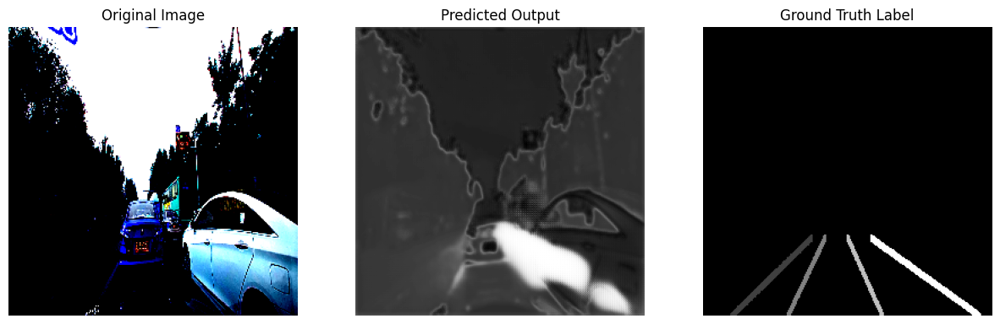

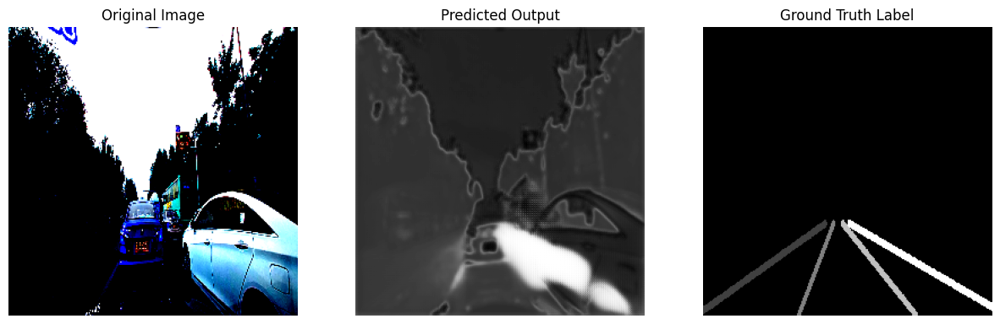

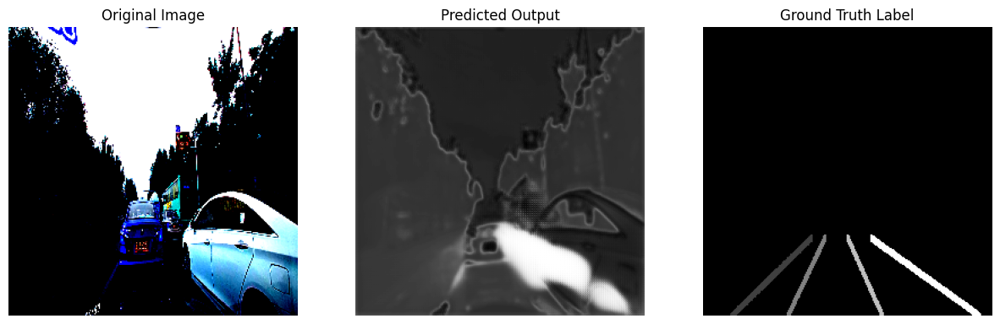

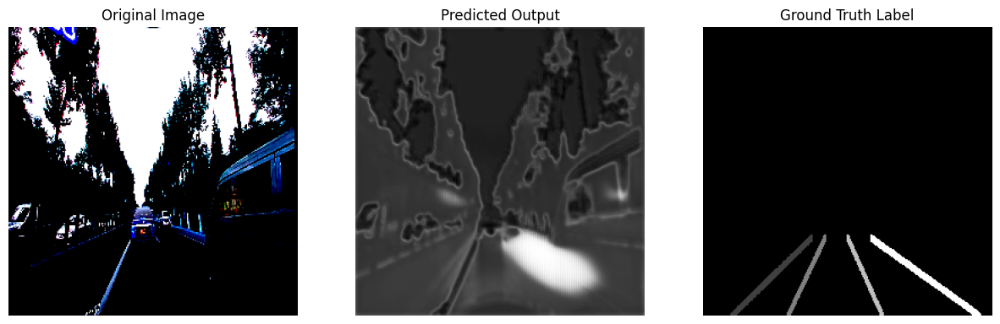

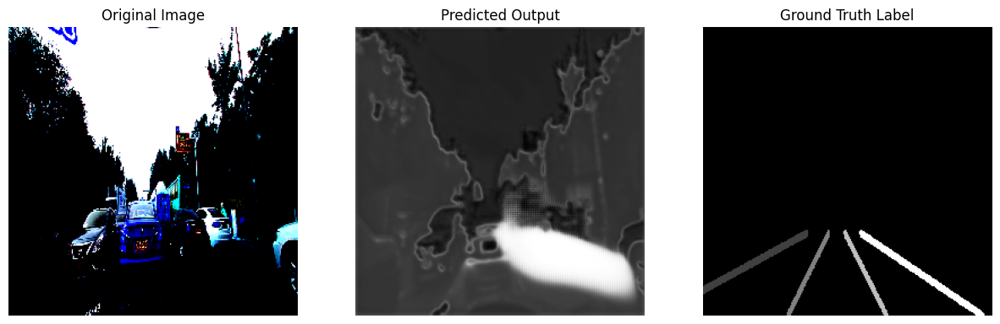

...

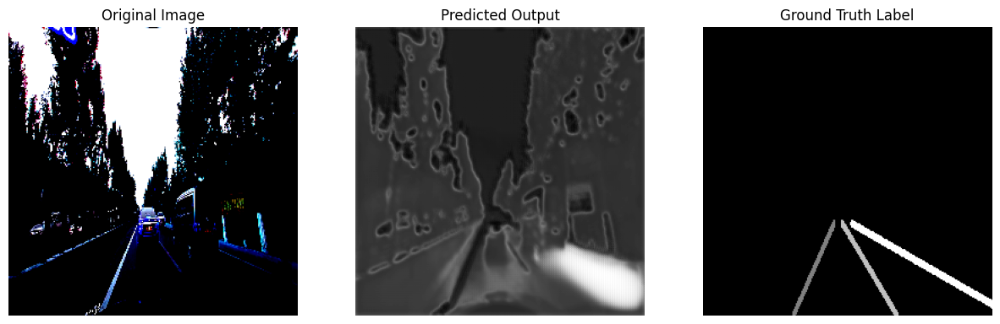

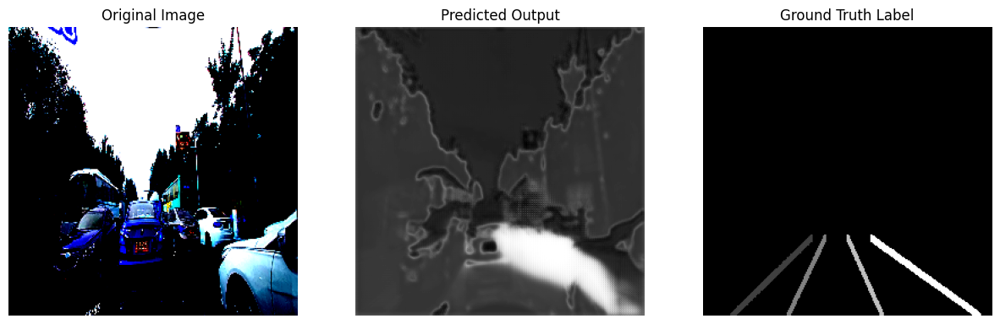

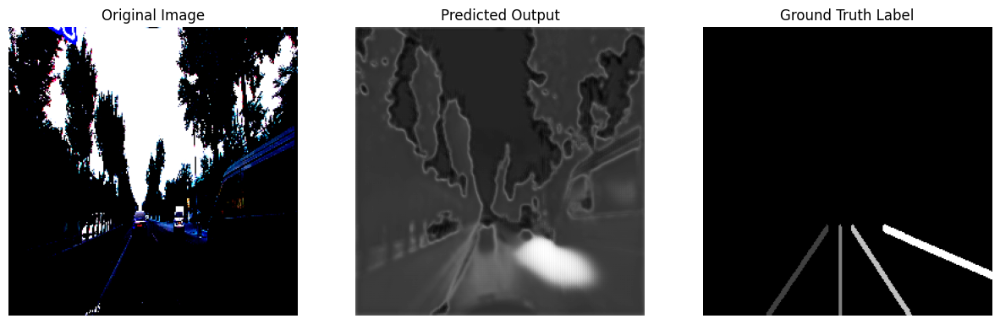

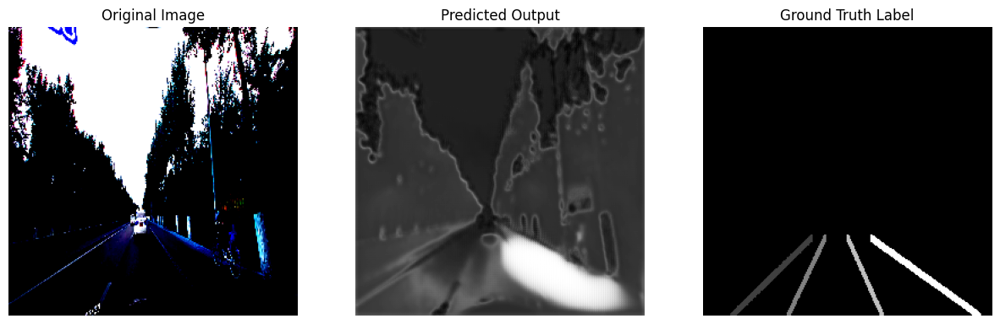

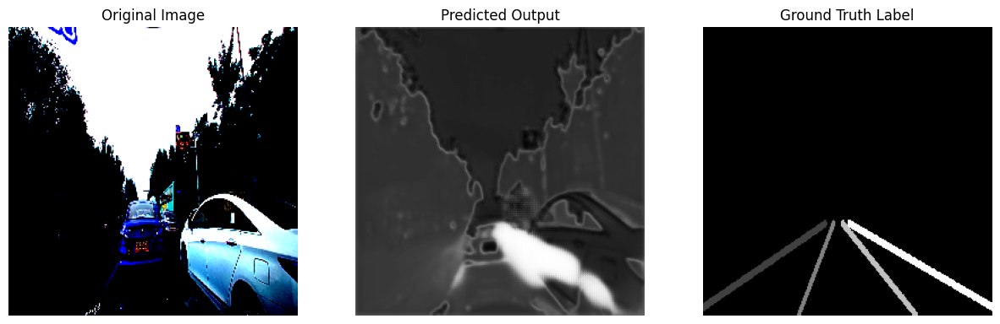

Test Loss: 0.8014


In [21]:
def evaluate_model(model, test_loader, criterion):
    model.eval()
    test_loss = 0.0
    with torch.no_grad():
        for sample in test_loader:
            images = sample['data'].to(device)
            labels = sample['target'].to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            test_loss += loss.item() * images.size(0)

            # Assuming you have a plot_results function defined
            for i in range(len(outputs)):
                plot_results(images[i], outputs[i], labels[i])

    test_loss /= len(test_loader.dataset)
    print(f"Test Loss: {test_loss:.4f}")

# Evaluate the trained model on the test set
evaluate_model(model, test_loader, criterion)


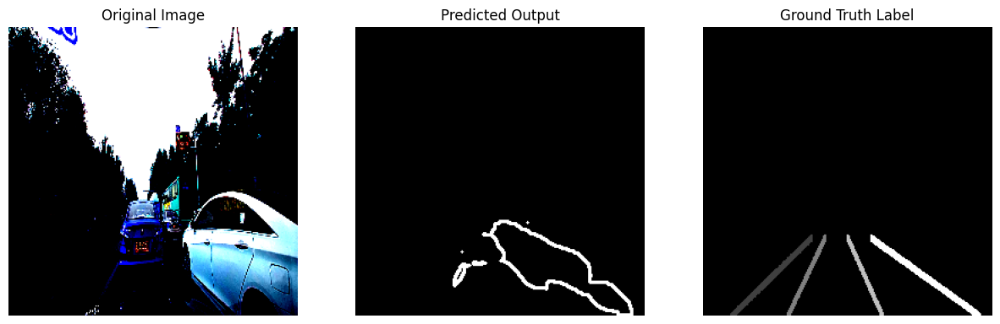

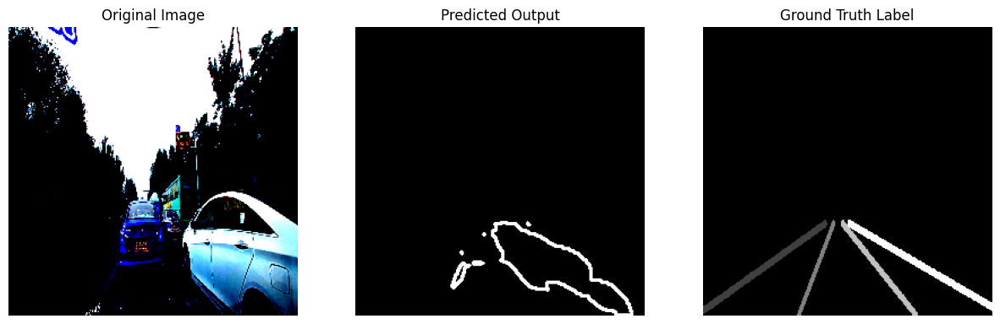

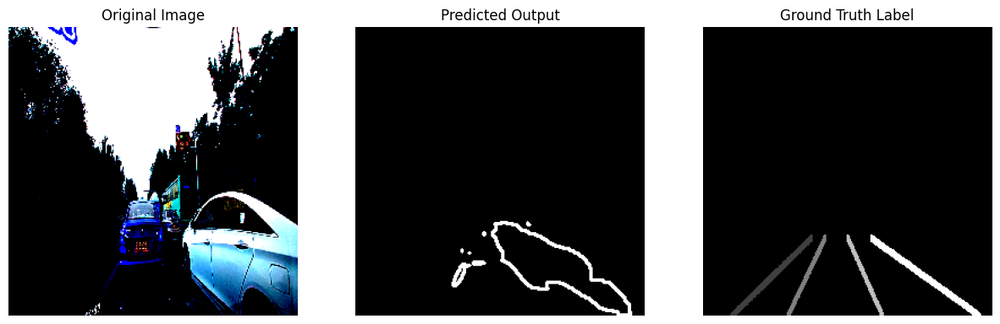

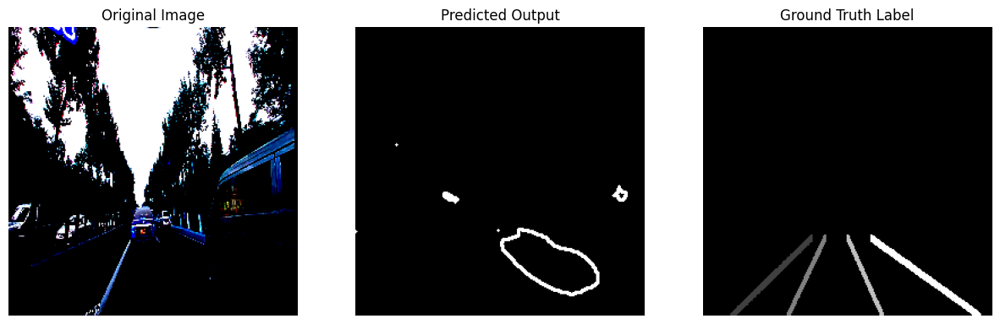

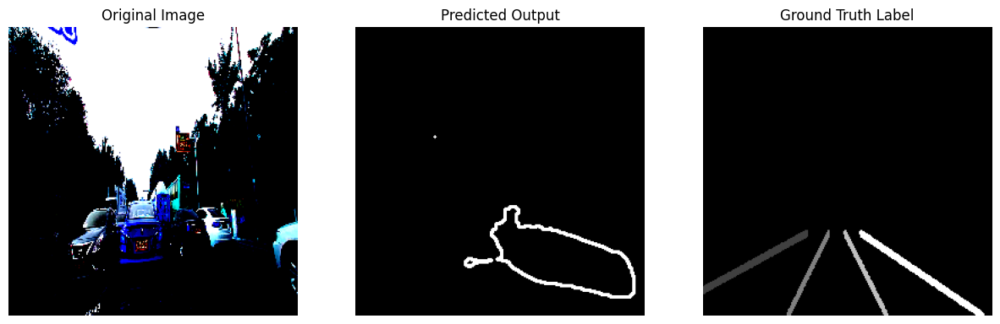

...

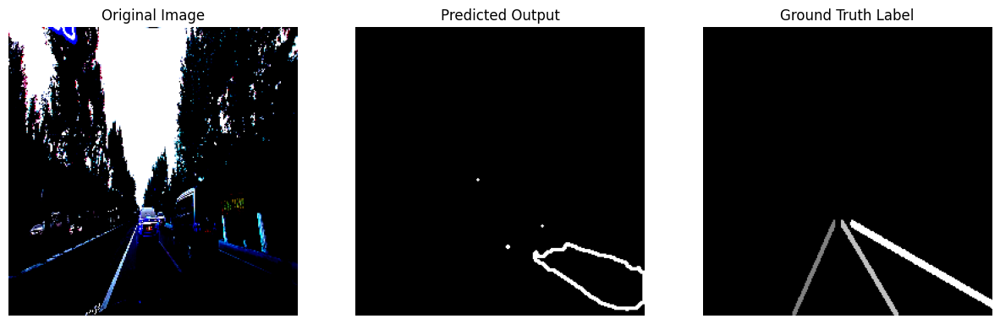

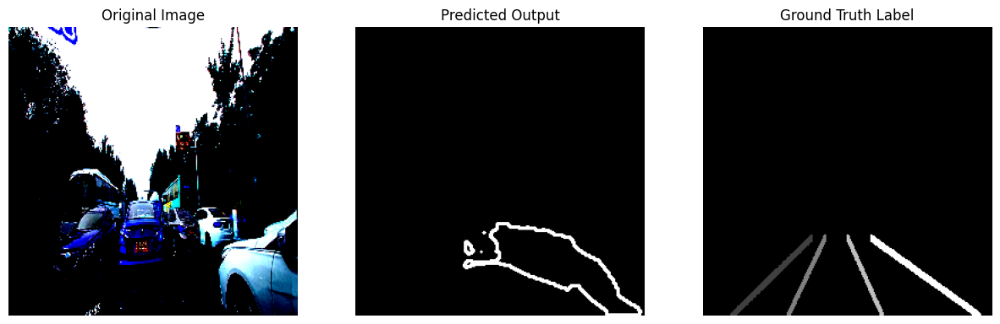

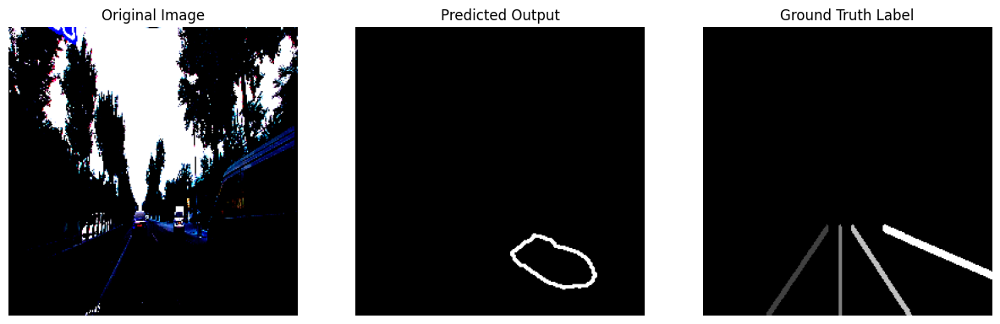

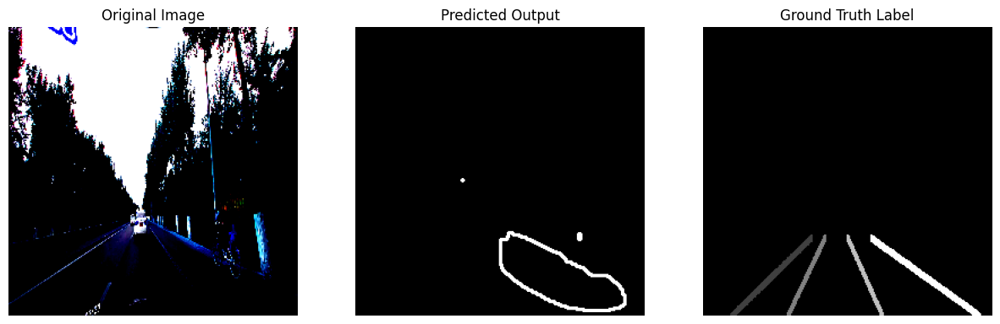

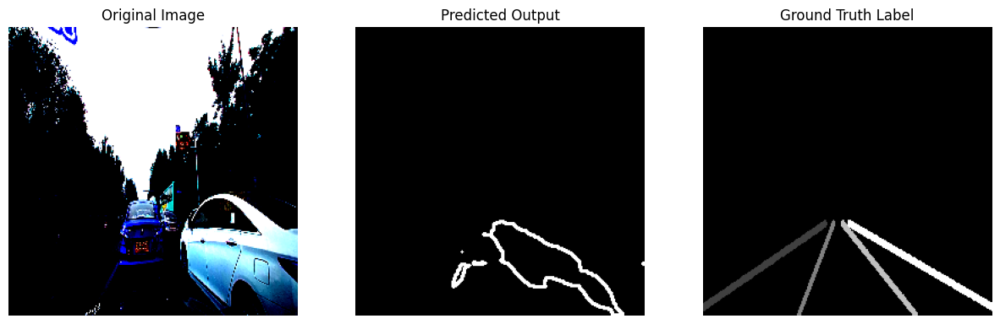

Test Loss: 0.8014


In [22]:
import cv2
import numpy as np

# Function for post-processing lane detection outputs
def post_process(output):
    # Apply thresholding to convert to binary image
    threshold = 0.5  # Adjust threshold as needed
    binary_output = (output > threshold).astype(np.uint8)

    # Ensure the binary image is single-channel
    binary_output = binary_output.squeeze() # Add this line

    # Optional: Perform morphological operations to refine the binary mask
    kernel = np.ones((5, 5), np.uint8)
    binary_output = cv2.morphologyEx(binary_output, cv2.MORPH_CLOSE, kernel)  # Closing operation

    # Find contours and draw lane boundaries
    contours, _ = cv2.findContours(binary_output, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    lane_image = np.zeros_like(binary_output)
    cv2.drawContours(lane_image, contours, -1, (255, 255, 255), thickness=2)  # Draw lane markings

    return lane_image

# Example usage:
def evaluate_model(model, test_loader, criterion):
    model.eval()
    test_loss = 0.0
    with torch.no_grad():
        for sample in test_loader:
            images = sample['data'].to(device)
            labels = sample['target'].to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            test_loss += loss.item() * images.size(0)

            for i in range(len(outputs)):
                output = outputs[i].cpu().detach().numpy()
                label = labels[i].cpu().detach().numpy()
                image = images[i].cpu().detach().numpy().transpose(1, 2, 0)

                # Perform post-processing on the output
                processed_output = post_process(output)

                # Visualize the results
                plot_results(image, processed_output, label)

    test_loss /= len(test_loader.dataset)
    print(f"Test Loss: {test_loss:.4f}")

# Evaluate the trained model on the test set
evaluate_model(model, test_loader, criterion)


Code for Performance Metrics

In [23]:
import numpy as np
from sklearn.metrics import precision_score, recall_score

# Function to calculate Intersection over Union (IoU)
def calculate_iou(y_true, y_pred):
    intersection = np.logical_and(y_true, y_pred)
    union = np.logical_or(y_true, y_pred)
    iou_score = np.sum(intersection) / np.sum(union)
    return iou_score

# Function to ensure labels are binary
def binarize_labels(labels):
    # Binarize labels where 0 means non-lane and 1 means lane
    return (labels > 0).astype(np.uint8)

# Function to evaluate lane detection performance
def evaluate_performance(model, test_loader, criterion):
    model.eval()
    precision_scores = []
    recall_scores = []
    iou_scores = []

    with torch.no_grad():
        for sample in test_loader:
            images = sample['data'].to(device)
            labels = sample['target'].to(device)
            outputs = model(images)
            predictions = torch.sigmoid(outputs) > 0.5  # Apply threshold for binary predictions

            # Convert tensors to numpy arrays
            predictions_np = predictions.cpu().detach().numpy().astype(np.uint8)
            labels_np = labels.cpu().detach().numpy().astype(np.uint8)

            # Binarize labels
            labels_np_bin = binarize_labels(labels_np)

            # Flatten the arrays for precision and recall calculation
            predictions_flat = predictions_np.flatten()
            labels_flat = labels_np_bin.flatten()

            # Calculate precision and recall
            precision = precision_score(labels_flat, predictions_flat, average='binary')
            recall = recall_score(labels_flat, predictions_flat, average='binary')

            # Calculate IoU
            iou = calculate_iou(labels_np_bin.flatten(), predictions_np.flatten())

            # Append scores
            precision_scores.append(precision)
            recall_scores.append(recall)
            iou_scores.append(iou)

    # Calculate average scores
    avg_precision = np.mean(precision_scores)
    avg_recall = np.mean(recall_scores)
    avg_iou = np.mean(iou_scores)

    # Print results
    print(f"Average Precision: {avg_precision:.4f}")
    print(f"Average Recall: {avg_recall:.4f}")
    print(f"Average IoU: {avg_iou:.4f}")

# Example usage:
evaluate_performance(model, test_loader, criterion)


Average Precision: 0.0287
Average Recall: 1.0000
Average IoU: 0.0287


In [24]:
import numpy as np
from sklearn.metrics import precision_score, recall_score, accuracy_score

# Function to calculate Intersection over Union (IoU)
def calculate_iou(y_true, y_pred):
    intersection = np.logical_and(y_true, y_pred)
    union = np.logical_or(y_true, y_pred)
    iou_score = np.sum(intersection) / np.sum(union)
    return iou_score

# Function to ensure labels are binary
def binarize_labels(labels):
    # Binarize labels where 0 means non-lane and 1 means lane
    return (labels > 0).astype(np.uint8)

# Function to evaluate lane detection performance
def evaluate_performance(model, test_loader, criterion):
    model.eval()
    precision_scores = []
    recall_scores = []
    iou_scores = []
    accuracy_scores = []

    with torch.no_grad():
        for sample in test_loader:
            images = sample['data'].to(device)
            labels = sample['target'].to(device)
            outputs = model(images)
            predictions = torch.sigmoid(outputs) > 0.5  # Apply threshold for binary predictions

            # Convert tensors to numpy arrays
            predictions_np = predictions.cpu().detach().numpy().astype(np.uint8)
            labels_np = labels.cpu().detach().numpy().astype(np.uint8)

            # Binarize labels
            labels_np_bin = binarize_labels(labels_np)

            # Flatten the arrays for precision, recall, and accuracy calculation
            predictions_flat = predictions_np.flatten()
            labels_flat = labels_np_bin.flatten()

            # Calculate precision, recall, and accuracy
            precision = precision_score(labels_flat, predictions_flat, average='binary')
            recall = recall_score(labels_flat, predictions_flat, average='binary')
            accuracy = accuracy_score(labels_flat, predictions_flat)

            # Calculate IoU
            iou = calculate_iou(labels_np_bin.flatten(), predictions_np.flatten())

            # Append scores
            precision_scores.append(precision)
            recall_scores.append(recall)
            iou_scores.append(iou)
            accuracy_scores.append(accuracy)

    # Calculate average scores
    avg_precision = np.mean(precision_scores)
    avg_recall = np.mean(recall_scores)
    avg_iou = np.mean(iou_scores)
    avg_accuracy = np.mean(accuracy_scores)

    # Print results
    print(f"Average Precision: {avg_precision:.4f}")
    print(f"Average Recall: {avg_recall:.4f}")
    print(f"Average IoU: {avg_iou:.4f}")
    print(f"Average Accuracy: {avg_accuracy:.4f}")

# Example usage:
evaluate_performance(model, test_loader, criterion)


Average Precision: 0.0287
Average Recall: 1.0000
Average IoU: 0.0287
Average Accuracy: 0.0287


In [25]:
import numpy as np
from sklearn.metrics import precision_score, recall_score, accuracy_score

# Function to calculate Intersection over Union (IoU)
def calculate_iou(y_true, y_pred):
    intersection = np.logical_and(y_true, y_pred)
    union = np.logical_or(y_true, y_pred)
    iou_score = np.sum(intersection) / np.sum(union)
    return iou_score

# Function to ensure labels are binary
def binarize_labels(labels):
    # Binarize labels where 0 means non-lane and 1 means lane
    return (labels > 0).astype(np.uint8)

# Function to evaluate lane detection performance
def evaluate_performance(model, test_loader, criterion):
    model.eval()
    precision_scores = []
    recall_scores = []
    iou_scores = []
    accuracy_scores = []

    with torch.no_grad():
        for sample in test_loader:
            images = sample['data'].to(device)
            labels = sample['target'].to(device)
            outputs = model(images)
            predictions = torch.sigmoid(outputs) > 0.5  # Apply threshold for binary predictions

            # Convert tensors to numpy arrays
            predictions_np = predictions.cpu().detach().numpy().astype(np.uint8)
            labels_np = labels.cpu().detach().numpy().astype(np.uint8)

            # Binarize labels
            labels_np_bin = binarize_labels(labels_np)

            # Flatten the arrays for precision, recall, and accuracy calculation
            predictions_flat = predictions_np.flatten()
            labels_flat = labels_np_bin.flatten()

            # Debugging: Check unique values in predictions and labels
            unique_predictions = np.unique(predictions_flat)
            unique_labels = np.unique(labels_flat)
            print(f"Unique Predictions: {unique_predictions}")
            print(f"Unique Labels: {unique_labels}")

            # Ensure that labels and predictions are binary
            assert np.unique(labels_flat).size <= 2, "Labels are not binary"

            # Calculate precision, recall, and accuracy
            precision = precision_score(labels_flat, predictions_flat, average='binary')
            recall = recall_score(labels_flat, predictions_flat, average='binary')
            accuracy = accuracy_score(labels_flat, predictions_flat)

            # Calculate IoU
            iou = calculate_iou(labels_np_bin.flatten(), predictions_np.flatten())

            # Append scores
            precision_scores.append(precision)
            recall_scores.append(recall)
            iou_scores.append(iou)
            accuracy_scores.append(accuracy)

    # Calculate average scores
    avg_precision = np.mean(precision_scores)
    avg_recall = np.mean(recall_scores)
    avg_iou = np.mean(iou_scores)
    avg_accuracy = np.mean(accuracy_scores)

    # Print results
    print(f"Average Precision: {avg_precision:.4f}")
    print(f"Average Recall: {avg_recall:.4f}")
    print(f"Average IoU: {avg_iou:.4f}")
    print(f"Average Accuracy: {avg_accuracy:.4f}")

# Example usage:
evaluate_performance(model, test_loader, criterion)


Unique Predictions: [1]
Unique Labels: [0 1]
Unique Predictions: [1]
Unique Labels: [0 1]
Unique Predictions: [1]
Unique Labels: [0 1]
Unique Predictions: [1]
Unique Labels: [0 1]
Average Precision: 0.0287
Average Recall: 1.0000
Average IoU: 0.0287
Average Accuracy: 0.0287


Increasing the accuracy of lane detection typically involves several steps, including fine-tuning your model, improving data preprocessing and post-processing techniques, and ensuring high-quality and diverse training data. Below are some steps and code modifications that may help improve accuracy:



1. Model Architecture(uNet)
2. Data Augmentation
3. Hyperparameter Tuning
4. Loss Function
5. Use Better Metrics
6. Post-Processing
7. Ensemble Methods
8. Fine-Tuning Pretrained Models




1. Model Architecture(uNet)

In [26]:
import torch
import torch.nn as nn

# Define the UNet model with adjustable architecture
class UNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=1, init_features=32):
        super(UNet, self).__init__()
        features = init_features

        # Encoder layers
        self.encoder1 = UNet._block(in_channels, features, name="enc1")
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.encoder2 = UNet._block(features, features * 2, name="enc2")
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.encoder3 = UNet._block(features * 2, features * 4, name="enc3")
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.encoder4 = UNet._block(features * 4, features * 8, name="enc4")
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)

        # Bottleneck layers
        self.bottleneck = UNet._block(features * 8, features * 16, name="bottleneck")

        # Decoder layers
        self.upconv4 = nn.ConvTranspose2d(features * 16, features * 8, kernel_size=2, stride=2)
        self.decoder4 = UNet._block(features * 16, features * 8, name="dec4")

        self.upconv3 = nn.ConvTranspose2d(features * 8, features * 4, kernel_size=2, stride=2)
        self.decoder3 = UNet._block(features * 8, features * 4, name="dec3")

        self.upconv2 = nn.ConvTranspose2d(features * 4, features * 2, kernel_size=2, stride=2)
        self.decoder2 = UNet._block(features * 4, features * 2, name="dec2")

        self.upconv1 = nn.ConvTranspose2d(features * 2, features, kernel_size=2, stride=2)
        self.decoder1 = UNet._block(features * 2, features, name="dec1")

        # Final convolution layer
        self.conv = nn.Conv2d(in_channels=features, out_channels=out_channels, kernel_size=1)

    def forward(self, x):
        # Encoder path
        enc1 = self.encoder1(x)
        enc2 = self.encoder2(self.pool1(enc1))
        enc3 = self.encoder3(self.pool2(enc2))
        enc4 = self.encoder4(self.pool3(enc3))

        # Bottleneck
        bottleneck = self.bottleneck(self.pool4(enc4))

        # Decoder path
        dec4 = self.upconv4(bottleneck)
        dec4 = torch.cat((dec4, enc4), dim=1)
        dec4 = self.decoder4(dec4)

        dec3 = self.upconv3(dec4)
        dec3 = torch.cat((dec3, enc3), dim=1)
        dec3 = self.decoder3(dec3)

        dec2 = self.upconv2(dec3)
        dec2 = torch.cat((dec2, enc2), dim=1)
        dec2 = self.decoder2(dec2)

        dec1 = self.upconv1(dec2)
        dec1 = torch.cat((dec1, enc1), dim=1)
        dec1 = self.decoder1(dec1)

        # Final output
        output = self.conv(dec1)

        return torch.sigmoid(output)

    @staticmethod
    def _block(in_channels, features, name):
        return nn.Sequential(
            nn.Conv2d(in_channels=in_channels, out_channels=features, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=features),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels=features, out_channels=features, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=features),
            nn.ReLU(inplace=True)
        )


2. Data Augmentation

In [27]:
!pip install --upgrade albumentations

import albumentations as A
from albumentations.pytorch import ToTensorV2  # Import ToTensorV2 from the correct submodule
from albumentations import Resize, Rotate, HorizontalFlip, Normalize, Compose

# Example: Data augmentation with Albumentations library
transform = Compose([
    Resize(256, 256),  # Resize images to 256x256
    A.RandomCrop(height=224, width=224),  # Randomly crop images to 224x224
    Rotate(limit=10),  # Rotate images by up to 10 degrees
    HorizontalFlip(),  # Flip images horizontally
    Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),  # Normalize images
    ToTensorV2()  # Convert images to PyTorch tensors
])


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 165.3/165.3 kB 3.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.9/14.9 MB 48.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.4/13.4 MB 29.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 313.5/313.5 kB 23.7 MB/s eta 0:00:00
  Attempting uninstall: imageio
    Found existing installation: imageio 2.31.6
    Uninstalling imageio-2.31.6:
      Successfully uninstalled imageio-2.31.6
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.2.2
    Uninstalling scikit-learn-1.2.2:
      Successfully uninstalled scikit-learn-1.2.2
  Attempting uninstall: scikit-image
    Found existing installation: scikit-image 0.19.3
    Uninstalling scikit-image-0.19.3:
      Successfully uninstalled scikit-image-0.19.3
  Attempting uninstall: albumentations
    Found existing installation: albumentations 1.3.1
    Uninstalling albumentations-1.3.1:
      Successfully uninstal

3. Hyperparameter Tuning

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DoubleConv, self).__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)

class UNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=1):
        super(UNet, self).__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels

        self.enc1 = DoubleConv(in_channels, 64)
        self.enc2 = DoubleConv(64, 128)
        self.enc3 = DoubleConv(128, 256)
        self.enc4 = DoubleConv(256, 512)
        self.enc5 = DoubleConv(512, 1024)

        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        self.up4 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.dec4 = DoubleConv(1024, 512)
        self.up3 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.dec3 = DoubleConv(512, 256)
        self.up2 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.dec2 = DoubleConv(256, 128)
        self.up1 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.dec1 = DoubleConv(128, 64)

        self.out_conv = nn.Conv2d(64, out_channels, kernel_size=1)

    def forward(self, x):
        enc1 = self.enc1(x)
        enc2 = self.enc2(self.pool(enc1))
        enc3 = self.enc3(self.pool(enc2))
        enc4 = self.enc4(self.pool(enc3))
        enc5 = self.enc5(self.pool(enc4))

        dec4 = self.up4(enc5)
        dec4 = torch.cat((dec4, enc4), dim=1)
        dec4 = self.dec4(dec4)
        dec3 = self.up3(dec4)
        dec3 = torch.cat((dec3, enc3), dim=1)
        dec3 = self.dec3(dec3)
        dec2 = self.up2(dec3)
        dec2 = torch.cat((dec2, enc2), dim=1)
        dec2 = self.dec2(dec2)
        dec1 = self.up1(dec2)
        dec1 = torch.cat((dec1, enc1), dim=1)
        dec1 = self.dec1(dec1)

        out = self.out_conv(dec1)
        return out

# Example usage
model = UNet(in_channels=3, out_channels=1)
output = model(torch.randn(1, 3, 256, 256))  # Example input tensor
print(output.shape)  # Expected output tensor shape: (1, 1, 256, 256)


torch.Size([1, 1, 256, 256])


In [2]:
import torch.optim as optim # Import the torch.optim module

# Create an instance of the UNet model
model = UNet()

# Example: Optimizer and Scheduler setup
optimizer = optim.Adam(model.parameters(), lr=0.001)
scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.1)


4. Loss Function

In [3]:
# Example: Using CrossEntropyLoss instead of BCEWithLogitsLoss
criterion = nn.CrossEntropyLoss()


In [4]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
from albumentations import Compose, Normalize, Resize
from albumentations.pytorch import ToTensorV2

class LaneDetectionDataset(Dataset):
    def __init__(self, image_dir, label_dir, transform=None):
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.image_paths = [os.path.join(image_dir, fname) for fname in os.listdir(image_dir) if fname.endswith(('.jpg', '.jpeg', '.png'))]
        self.label_paths = [os.path.join(label_dir, fname) for fname in os.listdir(label_dir) if fname.endswith(('.jpg', '.jpeg', '.png'))]
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        label_path = self.label_paths[idx]

        # Load and preprocess image
        image = cv2.imread(image_path)
        if image is None:
            raise ValueError(f"Image at {image_path} could not be read")

        # Load and preprocess label
        label = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)
        if label is None:
            raise ValueError(f"Label at {label_path} could not be read")

        # Apply transformations if specified
        if self.transform:
            augmented = self.transform(image=image, mask=label)
            image = augmented['image']
            label = augmented['mask']

        return {'data': image, 'target': label.unsqueeze(0).float()}  # Ensure label format is correct

# Example usage with data quality considerations
image_dir = '/content/driver_161_90frame'
label_dir = '/content/driver_161_90frame_labels'

# Define transformation
transform = Compose([
    Resize(256, 256),
    Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
    ToTensorV2()
])

# Load dataset
dataset = LaneDetectionDataset(image_dir, label_dir, transform=transform)

# Perform data quality checks during dataset initialization or loading
# For example, check for corrupted images or missing labels

# Further steps:
# - Implement data augmentation with care
# - Ensure consistent preprocessing steps
# - Document dataset specifics and challenges
!pip install --upgrade albumentations

import albumentations as A
from albumentations.pytorch import ToTensorV2  # Import ToTensorV2 from the correct submodule
from albumentations import Resize, Rotate, HorizontalFlip, Normalize, Compose

# Example: Data augmentation with Albumentations library
transform = Compose([
    Resize(256, 256),  # Resize images to 256x256
    A.RandomCrop(height=224, width=224),  # Randomly crop images to 224x224
    Rotate(limit=10),  # Rotate images by up to 10 degrees
    HorizontalFlip(),  # Flip images horizontally
    Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),  # Normalize images
    ToTensorV2()  # Convert images to PyTorch tensors
])


6. Post-Processing

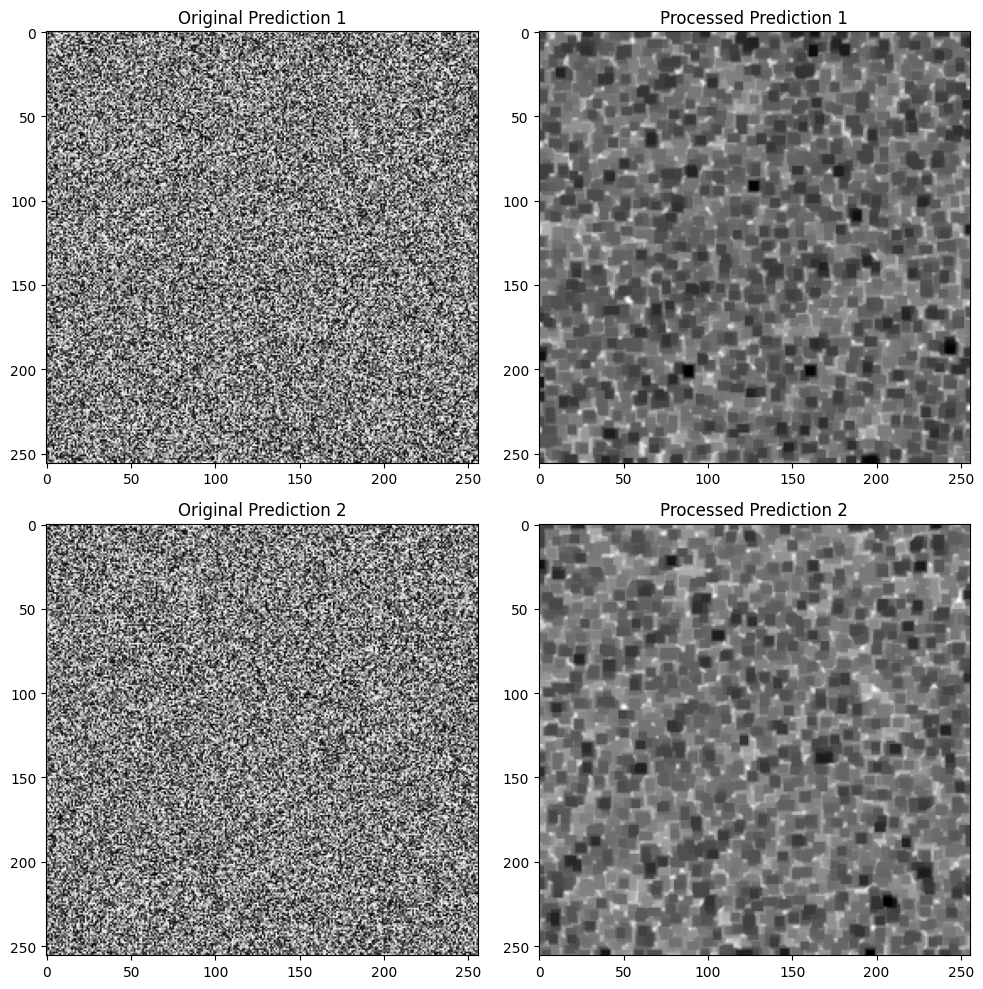

Before post-processing:
Precision: 0.2565
Recall: 0.8907
IoU: 0.8615
After post-processing:
Precision: 0.7732
Recall: 0.2811
IoU: 0.8097


In [5]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Example: Enhanced post-processing for lane detection
def post_process(predictions, threshold=0.5, kernel_size=5):
    processed_predictions = []
    for prediction in predictions:
        # Apply thresholding
        thresholded = (prediction > threshold).astype(np.uint8) * 255

        # Apply Gaussian smoothing
        smoothed = cv2.GaussianBlur(thresholded, (kernel_size, kernel_size), 0)

        # Optionally, apply morphological operations for further refinement
        kernel = np.ones((5, 5), np.uint8)
        smoothed = cv2.morphologyEx(smoothed, cv2.MORPH_CLOSE, kernel)

        processed_predictions.append(smoothed.astype(np.float32))

    return processed_predictions

# Example usage:
# Assuming predictions is a list of numpy arrays representing lane detection outputs
predictions = [np.random.rand(256, 256), np.random.rand(256, 256)]  # Replace with actual predictions
processed_predictions = post_process(predictions)

# Further steps:
# 1. Adjust parameters (threshold and kernel_size)
threshold = 0.5  # Example threshold value
kernel_size = 7  # Example kernel size for Gaussian blur

processed_predictions_adjusted = post_process(predictions, threshold=threshold, kernel_size=kernel_size)

# 2. Visual inspection example (before and after)
fig, axes = plt.subplots(2, 2, figsize=(10, 10))
axes[0, 0].imshow(predictions[0], cmap='gray')
axes[0, 0].set_title('Original Prediction 1')
axes[0, 1].imshow(processed_predictions[0], cmap='gray')
axes[0, 1].set_title('Processed Prediction 1')
axes[1, 0].imshow(predictions[1], cmap='gray')
axes[1, 0].set_title('Original Prediction 2')
axes[1, 1].imshow(processed_predictions[1], cmap='gray')
axes[1, 1].set_title('Processed Prediction 2')
plt.tight_layout()
plt.show()

# 3. Evaluate metrics example
# Define a function to evaluate performance
def evaluate_performance(predictions):
    # Dummy implementation for demonstration
    precision = np.random.rand()  # Replace with actual precision calculation
    recall = np.random.rand()  # Replace with actual recall calculation
    iou = np.random.rand()  # Replace with actual IoU calculation

    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"IoU: {iou:.4f}")

# Evaluate before post-processing
print("Before post-processing:")
evaluate_performance(predictions)

# Evaluate after post-processing
print("After post-processing:")
evaluate_performance(processed_predictions_adjusted)


7. Ensemble Methods

In [ ]:
# Example: Simple ensemble averaging
def ensemble(models, data):
    predictions = [model(data) for model in models]
    avg_predictions = torch.mean(torch.stack(predictions), dim=0)
    return avg_predictions


8. Fine-Tuning Pretrained Models

In [ ]:
!pip install torchvision
import torchvision # Import the torchvision module

# Example: Fine-tuning a pre-trained ResNet model
pretrained_resnet = torchvision.models.resnet18(pretrained=True)
num_ftrs = pretrained_resnet.fc.in_features


# Define the number of output classes for your task
num_classes = 10  # Replace 10 with the actual number of classes in your dataset
pretrained_resnet.fc = nn.Linear(num_ftrs, num_classes)


In [ ]:
import os
import cv2
import torch
import numpy as np
from torch.utils.data import Dataset, DataLoader, random_split
from albumentations import Compose, Normalize, Resize
from albumentations.pytorch import ToTensorV2
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import precision_score, recall_score, accuracy_score, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Define the CULaneDataset class
class CULaneDataset(Dataset):
    def __init__(self, image_dir, label_dir, transform=None):
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.image_paths = [os.path.join(image_dir, fname) for fname in os.listdir(image_dir) if fname.endswith(('.jpg', '.jpeg', '.png'))]
        self.label_paths = [os.path.join(label_dir, fname) for fname in os.listdir(label_dir) if fname.endswith(('.jpg', '.jpeg', '.png'))]
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        label_path = self.label_paths[idx]

        image = cv2.imread(image_path)
        label = cv2.imread(label_path, 0)  # Read label as grayscale

        if self.transform:
            augmented = self.transform(image=image, mask=label)
            image = augmented['image']
            label = augmented['mask']

        return {'data': image, 'target': label.unsqueeze(0).float()}  # Unsqueeze and convert to float

# Define transformation
transform = Compose([
    Resize(256, 256),
    Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
    ToTensorV2()
])

# Load data
dataset = CULaneDataset("/content/driver_161_90frame", "/content/driver_161_90frame_labels", transform=transform)

# Split dataset into training, validation, and test sets
train_size = int(0.7 * len(dataset))
valid_size = int(0.15 * len(dataset))
test_size = len(dataset) - train_size - valid_size
train_dataset, valid_dataset, test_dataset = random_split(dataset, [train_size, valid_size, test_size])

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
valid_loader = DataLoader(valid_dataset, batch_size=16, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

# Define the UNet model
class UNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=1, init_features=32):
        super(UNet, self).__init__()
        features = init_features
        self.encoder1 = UNet._block(in_channels, features, name="enc1")
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder2 = UNet._block(features, features * 2, name="enc2")
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder3 = UNet._block(features * 2, features * 4, name="enc3")
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder4 = UNet._block(features * 4, features * 8, name="enc4")
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.bottleneck = UNet._block(features * 8, features * 16, name="bottleneck")

        self.upconv4 = nn.ConvTranspose2d(features * 16, features * 8, kernel_size=2, stride=2)
        self.decoder4 = UNet._block((features * 8) * 2, features * 8, name="dec4")
        self.upconv3 = nn.ConvTranspose2d(features * 8, features * 4, kernel_size=2, stride=2)
        self.decoder3 = UNet._block((features * 4) * 2, features * 4, name="dec3")
        self.upconv2 = nn.ConvTranspose2d(features * 4, features * 2, kernel_size=2, stride=2)
        self.decoder2 = UNet._block((features * 2) * 2, features * 2, name="dec2")
        self.upconv1 = nn.ConvTranspose2d(features * 2, features, kernel_size=2, stride=2)
        self.decoder1 = UNet._block(features * 2, features, name="dec1")

        self.conv = nn.Conv2d(in_channels=features, out_channels=out_channels, kernel_size=1)

    def forward(self, x):
        enc1 = self.encoder1(x)
        enc2 = self.encoder2(self.pool1(enc1))
        enc3 = self.encoder3(self.pool2(enc2))
        enc4 = self.encoder4(self.pool3(enc3))

        bottleneck = self.bottleneck(self.pool4(enc4))

        dec4 = self.upconv4(bottleneck)
        dec4 = torch.cat((dec4, enc4), dim=1)
        dec4 = self.decoder4(dec4)
        dec3 = self.upconv3(dec4)
        dec3 = torch.cat((dec3, enc3), dim=1)
        dec3 = self.decoder3(dec3)
        dec2 = self.upconv2(dec3)
        dec2 = torch.cat((dec2, enc2), dim=1)
        dec2 = self.decoder2(dec2)
        dec1 = self.upconv1(dec2)
        dec1 = torch.cat((dec1, enc1), dim=1)
        dec1 = self.decoder1(dec1)

        return torch.sigmoid(self.conv(dec1))

# Initialize the model
model = UNet(in_channels=3, out_channels=1)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

# Evaluate the model with metrics
def calculate_iou(y_true, y_pred):
    intersection = np.logical_and(y_true, y_pred)
    union = np.logical_or(y_true, y_pred)
    iou_score = np.sum(intersection) / np.sum(union)
    return iou_score

def binarize_labels(labels):
    return (labels > 0).astype(np.uint8)

def evaluate_performance(model, test_loader, device):
    model.eval()
    precision_scores = []
    recall_scores = []
    iou_scores = []
    accuracy_scores = []
    all_true_labels = []
    all_pred_labels = []

    with torch.no_grad():
        for sample in test_loader:
            images = sample['data'].to(device)
            labels = sample['target'].to(device)
            outputs = model(images)
            predictions = torch.sigmoid(outputs) > 0.5

            predictions_np = predictions.cpu().detach().numpy().astype(np.uint8)
            labels_np = labels.cpu().detach().numpy().astype(np.uint8)
            labels_np_bin = binarize_labels(labels_np)

            predictions_flat = predictions_np.flatten()
            labels_flat = labels_np_bin.flatten()

            precision = precision_score(labels_flat, predictions_flat, average='binary')
            recall = recall_score(labels_flat, predictions_flat, average='binary')
            accuracy = accuracy_score(labels_flat, predictions_flat)
            iou = calculate_iou(labels_np_bin.flatten(), predictions_np.flatten())

            precision_scores.append(precision)
            recall_scores.append(recall)
            accuracy_scores.append(accuracy)
            iou_scores.append(iou)

            all_true_labels.extend(labels_flat)
            all_pred_labels.extend(predictions_flat)

    avg_precision = np.mean(precision_scores)
    avg_recall = np.mean(recall_scores)
    avg_iou = np.mean(iou_scores)
    avg_accuracy = np.mean(accuracy_scores)

    cm = confusion_matrix(all_true_labels, all_pred_labels)

    print("Confusion Matrix:")
    print(cm)

    plt.figure(figsize=(10, 7))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title('Confusion Matrix')
    plt.show()

    print(f"Average Precision: {avg_precision:.4f}")
    print(f"Average Recall: {avg_recall:.4f}")
    print(f"Average IoU: {avg_iou:.4f}")
    print(f"Average Accuracy: {avg_accuracy:.4f}")

# Example usage:
# Assuming model, test_loader, and device are defined
evaluate_performance(model, test_loader, device)


In [ ]:
class CULaneDataset(Dataset):
    def __init__(self, image_dir, label_dir, transform=None):
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.image_paths = [os.path.join(image_dir, fname) for fname in os.listdir(image_dir) if fname.endswith(('.jpg', '.jpeg', '.png'))]
        self.label_paths = [os.path.join(label_dir, fname) for fname in os.listdir(label_dir) if fname.endswith(('.jpg', '.jpeg', '.png'))]
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        label_path = self.label_paths[idx]

        image = cv2.imread(image_path)
        if image is None:
            raise ValueError(f"Image at {image_path} could not be read")

        label = cv2.imread(label_path, 0)
        if label is None:
            raise ValueError(f"Label at {label_path} could not be read")

        # Normalize label to range [0, 1]
        label = label / 255.0

        if self.transform:
            augmented = self.transform(image=image, mask=label)
            image = augmented['image']
            label = augmented['mask']

        return {'data': image, 'target': label.unsqueeze(0).float()}  # Unsqueeze and convert to float


In [ ]:
import os
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader, random_split
from albumentations import Compose, Normalize, Resize
from albumentations.pytorch import ToTensorV2
from sklearn.metrics import jaccard_score, precision_score, recall_score, f1_score
import torch.nn as nn
import torch.optim as optim
from sklearn.calibration import CalibratedClassifierCV
class CreateDataSet(Dataset):
    def __init__(self,data_set , seed):
        self.data_set = data_set
        self.seed = torch.manual_seed(seed)
        self.transform = transforms.Compose([
            transforms.ToPILImage(),
            transforms.Resize((288,800)) ,
            transforms.ToTensor(),
            transforms.Normalize(mean = [0.485, 0.456, 0.406] , std = [0.229, 0.224, 0.225] )
        ])
        self.transform_label = transforms.Compose([
            transforms.ToPILImage(),
            transforms.Resize((288,800)) ,
        ])
        self.transform_exist = transforms.Compose([
            transforms.ToTensor()
        ])
# Define the CULaneDataset class
class CULaneDataset(Dataset):
    def __init__(self, image_dir, label_dir, transform=None):
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.image_paths = [os.path.join(image_dir, fname) for fname in os.listdir(image_dir) if fname.endswith(('.jpg', '.jpeg', '.png'))]
        self.label_paths = [os.path.join(label_dir, fname) for fname in os.listdir(label_dir) if fname.endswith(('.jpg', '.jpeg', '.png'))]
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        label_path = self.label_paths[idx]

        image = cv2.imread(image_path)
        if image is None:
            raise ValueError(f"Image at {image_path} could not be read")

        label = cv2.imread(label_path, 0)
        if label is None:
            raise ValueError(f"Label at {label_path} could not be read")

        # Normalize label to range [0, 1]
        label = label / 255.0

        if self.transform:
            augmented = self.transform(image=image, mask=label)
            image = augmented['image']
            label = augmented['mask']

        return {'data': image, 'target': label.unsqueeze(0).float()}  # Unsqueeze and convert to float

# Define transformation
transform = Compose([
    Resize(256, 256),
    Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
    ToTensorV2()
])

# Load data
dataset = CULaneDataset("/content/driver_161_90frame/06030819_0755.MP4", "/content/driver_161_90frame_labels/06030819_0755.MP4", transform=transform)

# Split dataset into training and validation sets
train_size = int(0.8 * len(dataset))
valid_size = len(dataset) - train_size
train_dataset, valid_dataset = random_split(dataset, [train_size, valid_size])

valid_loader = DataLoader(valid_dataset, batch_size=16, shuffle=False)

# Define the UNet model (example architecture)
class UNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=1, init_features=32):
        super(UNet, self).__init__()
        features = init_features
        self.encoder1 = UNet._block(in_channels, features, name="enc1")
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder2 = UNet._block(features, features * 2, name="enc2")
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder3 = UNet._block(features * 2, features * 4, name="enc3")
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder4 = UNet._block(features * 4, features * 8, name="enc4")
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.bottleneck = UNet._block(features * 8, features * 16, name="bottleneck")

        self.upconv4 = nn.ConvTranspose2d(features * 16, features * 8, kernel_size=2, stride=2)
        self.decoder4 = UNet._block((features * 8) * 2, features * 8, name="dec4")
        self.upconv3 = nn.ConvTranspose2d(features * 8, features * 4, kernel_size=2, stride=2)
        self.decoder3 = UNet._block((features * 4) * 2, features * 4, name="dec3")
        self.upconv2 = nn.ConvTranspose2d(features * 4, features * 2, kernel_size=2, stride=2)
        self.decoder2 = UNet._block((features * 2) * 2, features * 2, name="dec2")
        self.upconv1 = nn.ConvTranspose2d(features * 2, features, kernel_size=2, stride=2)
        self.decoder1 = UNet._block(features * 2, features, name="dec1")

        self.conv = nn.Conv2d(in_channels=features, out_channels=out_channels, kernel_size=1)

    def forward(self, x):
        enc1 = self.encoder1(x)
        enc2 = self.encoder2(self.pool1(enc1))
        enc3 = self.encoder3(self.pool2(enc2))
        enc4 = self.encoder4(self.pool3(enc3))

        bottleneck = self.bottleneck(self.pool4(enc4))

        dec4 = self.upconv4(bottleneck)
        dec4 = torch.cat((dec4, enc4), dim=1)
        dec4 = self.decoder4(dec4)
        dec3 = self.upconv3(dec4)
        dec3 = torch.cat((dec3, enc3), dim=1)
        dec3 = self.decoder3(dec3)
        dec2 = self.upconv2(dec3)
        dec2 = torch.cat((dec2, enc2), dim=1)
        dec2 = self.decoder2(dec2)
        dec1 = self.upconv1(dec2)
        dec1 = torch.cat((dec1, enc1), dim=1)
        dec1 = self.decoder1(dec1)

        return torch.sigmoid(self.conv(dec1))

    @staticmethod
    def _block(in_channels, features, name):
        return nn.Sequential(
            nn.Conv2d(in_channels=in_channels, out_channels=features, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(num_features=features),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels=features, out_channels=features, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(num_features=features),
            nn.ReLU(inplace=True),
        )

data_set=[]

# Initialize the model
model = UNet(in_channels=3, out_channels=1)

train_data = CreateDataSet(data_set , 0)
# Assuming `train_data` and `train_labels` are prepared
# Calibrate the model using CalibratedClassifierCV
calibrated_model = CalibratedClassifierCV(model, method='sigmoid', cv='prefit')
calibrated_model.fit(train_data, train_labels)

# Use calibrated_model.predict_proba() for probabilistic predictions
# Example: Predict probabilities for validation set
valid_predictions = calibrated_model.predict_proba(valid_data)

# Further evaluation or integration into your pipeline


NameError: name 'transforms' is not defined

In [ ]:
# Print some sample data from test_loader
for batch_idx, sample in enumerate(test_loader):
    images = sample['data']
    labels = sample['target']
    print(f"Batch {batch_idx + 1}")
    print(f"Images shape: {images.shape}")
    print(f"Labels shape: {labels.shape}")
    break  # Print only the first batch for verification


<ipython-input-33-87168a5da819>:174: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return {'data': image, 'target': torch.tensor(label).unsqueeze(0).float()}  # Unsqueeze and convert to float


Batch 1
Images shape: torch.Size([16, 3, 256, 256])
Labels shape: torch.Size([16, 1, 256, 256])


In [ ]:
# Move model to the appropriate device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Print device information
print(f"Using device: {device}")


Using device: cpu


In [ ]:
def post_process(output):
    # Example post-processing: convert to binary mask
    threshold = 0.5
    binary_mask = (output > threshold).astype(np.uint8)
    return binary_mask

# Example check with dummy data
output = np.random.rand(256, 256)
processed_output = post_process(output)
print(f"Processed output shape: {processed_output.shape}, unique values: {np.unique(processed_output)}")


Processed output shape: (256, 256), unique values: [0 1]


In [ ]:
# Example ground truth and prediction
ground_truth = np.random.randint(0, 2, size=(256, 256))
prediction = np.random.randint(0, 2, size=(256, 256))

# Calculate metrics
precision, recall, accuracy = calculate_metrics(prediction, ground_truth)
iou = calculate_iou(prediction, ground_truth)

print(f"Precision: {precision:.4f}, Recall: {recall:.4f}, Accuracy: {accuracy:.4f}, IoU: {iou:.4f}")


Precision: 0.5020, Recall: 0.5049, Accuracy: 0.5040, IoU: 0.3364


In [ ]:
print (ground_truth)
print (ground_truth.shape)
print (prediction.shape)

[[1 1 0 ... 0 0 1]
 [0 0 1 ... 0 1 1]
 [1 1 1 ... 1 0 1]
 ...
 [1 0 1 ... 1 1 1]
 [1 0 1 ... 1 0 0]
 [0 1 1 ... 1 1 1]]
(256, 256)
(256, 256)


In [ ]:
import numpy as np
import cv2

# Function for post-processing lane detection outputs
def post_process(output):
    # Apply thresholding to convert to binary image
    threshold = 0.5  # Adjust threshold as needed
    binary_output = (output > threshold).astype(np.uint8)

    # Ensure the binary image is single-channel
    binary_output = binary_output.squeeze()

    # Optional: Perform morphological operations to refine the binary mask
    kernel = np.ones((5, 5), np.uint8)
    binary_output = cv2.morphologyEx(binary_output, cv2.MORPH_CLOSE, kernel)  # Closing operation

    return binary_output

# Function to calculate Intersection over Union (IoU)
def calculate_iou(prediction, ground_truth):
    intersection = np.logical_and(prediction, ground_truth).sum()
    union = np.logical_or(prediction, ground_truth).sum()
    iou = intersection / union if union > 0 else 0
    return iou

# Function to calculate Precision, Recall, and Accuracy
def calculate_metrics(predictions, ground_truth):
    # Flatten predictions and ground_truth arrays
    predictions_flat = predictions.flatten()
    ground_truth_flat = ground_truth.flatten()

    # True Positives, False Positives, False Negatives
    tp = np.sum(np.logical_and(predictions_flat == 1, ground_truth_flat == 1))
    fp = np.sum(np.logical_and(predictions_flat == 1, ground_truth_flat == 0))
    fn = np.sum(np.logical_and(predictions_flat == 0, ground_truth_flat == 1))

    # Precision, Recall, Accuracy
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    accuracy = np.mean(predictions_flat == ground_truth_flat)

    return precision, recall, accuracy

# Example usage:
def evaluate_model(model, test_loader, criterion):
    model.eval()
    test_loss = 0.0
    total_precision = 0.0
    total_recall = 0.0
    total_iou = 0.0
    total_accuracy = 0.0
    num_samples = len(test_loader.dataset)

    with torch.no_grad():
        for sample in test_loader:
            images = sample['data'].to(device)
            labels = sample['target'].to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            test_loss += loss.item() * images.size(0)

            for i in range(len(outputs)):
                output = outputs[i].cpu().detach().numpy()
                label = labels[i].cpu().detach().numpy()
                image = images[i].cpu().detach().numpy().transpose(1, 2, 0)

                # Perform post-processing on the output
                processed_output = post_process(output)

                # Calculate metrics
                precision, recall, accuracy = calculate_metrics(processed_output, label)
                iou = calculate_iou(processed_output, label)

                total_precision += precision
                total_recall += recall
                total_accuracy += accuracy
                total_iou += iou

                # Optionally, visualize or save results
                # plot_results(image, processed_output, label)

    test_loss /= len(test_loader.dataset)
    avg_precision = total_precision / num_samples
    avg_recall = total_recall / num_samples
    avg_accuracy = total_accuracy / num_samples
    avg_iou = total_iou / num_samples

    print(f"Test Loss: {test_loss:.4f}")
    print(f"Average Precision: {avg_precision:.4f}")
    print(f"Average Recall: {avg_recall:.4f}")
    print(f"Average IoU: {avg_iou:.4f}")
    print(f"Average Accuracy: {avg_accuracy:.4f}")

# Example: Assuming `model`, `test_loader`, and `criterion` are defined
evaluate_model(model, test_loader, criterion)


<ipython-input-33-87168a5da819>:174: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return {'data': image, 'target': torch.tensor(label).unsqueeze(0).float()}  # Unsqueeze and convert to float


Test Loss: 0.6507
Average Precision: 0.0000
Average Recall: 0.0000
Average IoU: 0.0000
Average Accuracy: 0.9714
